# Imports

In [ ]:
import os 
import warnings

warnings.filterwarnings("ignore")
os.chdir("/Users/erjo3868/repos/hypedsearch/hypedsearch")
print(f"cwd = {os.getcwd()}")

import time
from src.erik import load_comet_data
import numpy as np
from src.erik import (
    get_data_for_spectrum, 
    get_b_y_ion_sequences, 
    get_b_ion_sequences, 
    get_y_ion_sequences, 
    load_mzml_data,
    get_specific_spectrum,
    mass_difference_in_ppm,
    get_ion_matches_between_peptide_and_spectrum_peaks,
    compare_comet_output_row_to_corresponding_spectrum,
    get_indices_of_largest_elements,
    compare_peptide_to_spectrum,
    relative_ppm_tolerance_in_daltons,
    top_n_peak_filtering
)
from src.lookups.protein_product_ion_db import (
    compute_b_ion_neutral_mass,
    compute_y_ion_neutral_mass,
    ProteinProductIonDb,
    create_protein_product_ion_db,
)
from src.erik_utils import run_in_parallel, timeit
from src.constants import (
    SAMPLE, SCAN,
    PLOTS_DIR,
    PLAIN_PEPTIDE,
    Y_ION_AS_INT, 
    B_ION_AS_INT
)
from src.lookups.data_classes import (
    PeakIonMatches
)
from typing import Counter
import seaborn as sns
from src.plot_utils import fig_setup, finalize, set_title_axes_labels
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from src.fasta_utils import get_proteins_from_fasta, get_specific_protein_from_fasta

PMZ = "precursor_mz"
PC = "precursor_charge"
C = "charge"
ENM = "exp_neutral_mass"
XC = "xcorr"
PP = "plain_peptide"
PL = "peptide_len"
IM = "ions_matched"


cwd = /Users/erjo3868/repos/hypedsearch/hypedsearch


# Load data

## Load MZML data

In [104]:
spectra = load_mzml_data()

Reading sample BMEM_AspN_Fxn4's MZML
Reading sample BMEM_AspN_Fxn5's MZML
Reading sample BMEM_AspN_Fxn6's MZML
Reading sample BMEM_AspN_Fxn7's MZML
Reading sample BMEM_AspN_Fxn8's MZML
Reading sample BMEM_AspN_Fxn9's MZML


## Load Comet run 1 data

In [10]:
comet_df = load_comet_data()
comet_df.head(2)

Reading data for BMEM_AspN_Fxn4
Reading data for BMEM_AspN_Fxn5
Reading data for BMEM_AspN_Fxn6
Reading data for BMEM_AspN_Fxn7
Reading data for BMEM_AspN_Fxn8
Reading data for BMEM_AspN_Fxn9


,scan,num,charge,exp_neutral_mass,calc_neutral_mass,e-value,xcorr,delta_cn,sp_score,ions_matched,...,plain_peptide,modified_peptide,prev_aa,next_aa,protein,protein_count,modifications,retention_time_sec,sp_rank,sample
0,7,1,3,1525.774133,1525.773636,0.000202,2.187,0.4294,229.0,15,...,SAAPAAGSAPAAAEEKK,G.SAAPAAGSAPAAAEEKK.D,G,D,"tr|A0A5F8MPY2|A0A5F8MPY2_MOUSE,sp|P99027|RLA2_...",2,-,714.0,1,BMEM_AspN_Fxn4
1,7,2,3,1525.774133,1525.773636,2.030000,1.248,0.0200,26.0,6,...,AAQTPGSGEAVLSKNP,T.AAQTPGSGEAVLSKNP.N,T,N,sp|Q8BI84|TGO1_MOUSE,1,-,714.0,16,BMEM_AspN_Fxn4


# Comet Run 1 summary results and plots

## plain_peptide lengths

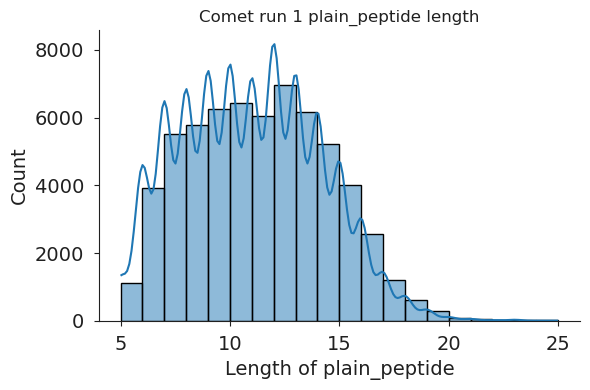

In [207]:
data = [len(aa_seq) for aa_seq in comet_df.plain_peptide]

_, axs = fig_setup(1,1)
n_bins = 20

ax = axs[0]
_=sns.histplot(
    data,
    ax=ax,
    bins=n_bins,
    kde=True,
)
set_title_axes_labels(
    ax=ax,
    xlabel="Length of plain_peptide",
    #  "" / (total_num_peaks)",
    ylabel="Count", 
    title="Comet run 1 plain_peptide length"
)
finalize(axs)
# ax.legend(loc="upper right", bbox_to_anchor=(1.5, 0.9))
plt.tight_layout()
plt.savefig(PLOTS_DIR / "comet_run_1_plain_peptide_len_histogram.png", dpi=200)

## Distribution of precursor charge

In [209]:
Counter(comet_df.charge)

Counter({2: 47120, 3: 15203})

In [ ]:
# Constants
from src.erik import compare_peptide_to_spectrum
from src.constants import PLAIN_PEPTIDE

testing = False
num_psms_to_analyze = 200
ppm_tolerance = 10
charges_to_consider = [1, 2, 3]
top_n_peak_values = [None, 50]

# TESTING
if testing is True:
    print("--TESTING--")
    num_psms_to_analyze = 3
    charges_to_consider = [1, 2]

# Make dataframe with one row per spectrum and that row is the highest scoring row for the spectrum
df = []
for group_name, group in comet_df.groupby([SCAN, SAMPLE]):
    group.sort_values(by="xcorr", ascending=False, inplace=True)
    df.append(group.iloc[0].to_dict())
df = pd.DataFrame(df)

# Get high scoring peptide-spectrum matches and only use one per spectrum
# df.head(5)
df.sort_values(by="xcorr", ascending=False, inplace=True)
df.reset_index(inplace=True, drop=True)
# df.head(5)
high_scoring_psms = df.iloc[:num_psms_to_analyze]

filtering = {top_n_peaks: [] for top_n_peaks in top_n_peak_values}
t0 = time.time()
for row_idx, row in high_scoring_psms.iterrows():
    spectrum = get_specific_spectrum(sample=row[SAMPLE], scan_num=row[SCAN])

    # Timing
    per_row_time = time.time()
    if row_idx % 10 == 0: 
        print(f"Row = {row_idx+1} of {high_scoring_psms.shape[0]}")

    
    for top_n_peaks in top_n_peak_values:
        filtering[top_n_peaks].append(
            compare_peptide_to_spectrum(
                spectrum=spectrum, 
                peptide=row[PLAIN_PEPTIDE], 
                charges_to_consider=charges_to_consider, 
                top_n_peaks=top_n_peaks,
                ppm_tolerance=ppm_tolerance
            )
        )
print(f"Took {time.time()-t0:.3f} seconds")

Row = 1 of 200


KeyboardInterrupt: 

In [140]:
# Combmine with Comet data
for top_n_peaks in top_n_peak_values:
    filtering[top_n_peaks] = pd.concat(
        [high_scoring_psms, pd.DataFrame(filtering[top_n_peaks])], 
        axis=1
    )

Text(0.5, 0.98, '200 highest-xcorr scoring PSMs.\n Filtered to 50 most abundant peaks')

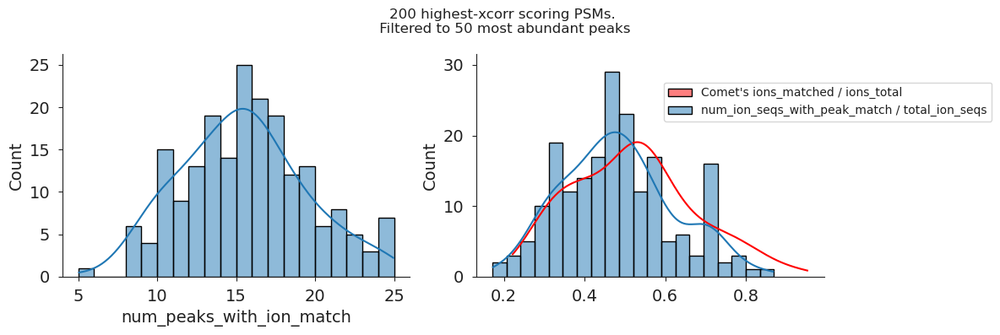

In [ ]:
# Plots
import seaborn as sns
import matplotlib.pyplot as plt

# Filtered data
data = filtering[50]

_, axs = fig_setup(1, 2)
n_bins = 20

ax = axs[0]
_=sns.histplot(
    data.num_peaks_with_ion_match,
    ax=ax,
    bins=n_bins,
    kde=True,
)
set_title_axes_labels(
    ax=ax,
    xlabel="num_peaks_with_ion_match",
    #  "" / (total_num_peaks)",
    ylabel="Count", 
)

ax = axs[1]

# Comet 
x = sns.histplot(
    data.ions_matched / data.ions_total,
    bins=n_bins, 
    kde=True, 
    ax=ax,
    color="red",
    label="Comet's ions_matched / ions_total"
)
# Hides histogram bars
for patch in x.patches:
    patch.remove()

_=sns.histplot(
    data.num_ion_seqs_with_peak_match / data.total_ion_seqs,
    ax=ax,
    bins=n_bins,
    kde=True,
    label="num_ion_seqs_with_peak_match / total_ion_seqs",
)
set_title_axes_labels(
    ax=ax,
    # xlabel="num_ion_seqs_with_peak_match / total_ion_seqs",
    #  "" / (total_num_peaks)",
    ylabel="Count", 
)
plt.suptitle(f"{num_psms_to_analyze} highest-{XC} scoring PSMs.\n Filtered to 50 most abundant peaks")
finalize(axs)
ax.legend(loc="upper right", bbox_to_anchor=(1.5, 0.9))

plt.tight_layout()

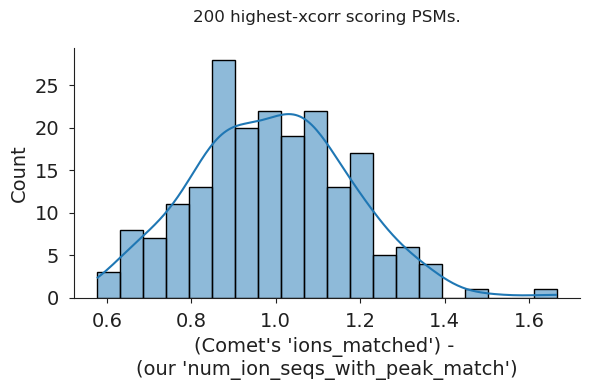

In [166]:
# Unfiltered data
data = filtering[None]

_, axs = fig_setup()
n_bins = 20

ax = axs[0]
_=sns.histplot(
    data.ions_matched / data.num_peaks_with_ion_match,
    ax=ax,
    bins=n_bins,
    kde=True,
)
title = f"{num_psms_to_analyze} highest-{XC} scoring PSMs.\n"
set_title_axes_labels(
    ax=ax,
    xlabel="(Comet's 'ions_matched') - \n(our 'num_ion_seqs_with_peak_match')",
    ylabel="Count", 
    title=title
)
finalize(axs)
plt.tight_layout()

,scan,num,charge,exp_neutral_mass,calc_neutral_mass,e-value,xcorr,delta_cn,sp_score,ions_matched,...,retention_time_sec,sp_rank,sample,aa_seq,total_num_peaks,num_peaks_with_ion_match,total_ion_seqs,num_ion_seqs_with_peak_match,charges_to_consider,top_n_peaks
0,2652,1,3,1376.701214,1376.700988,8.370000e-11,5.491,0.6003,2103.0,32,...,1787.0,1,BMEM_AspN_Fxn7,YMVGPIEEAVAKA,712,31,25,23,"[1, 2, 3]",None
1,3297,1,3,1464.721064,1464.720872,6.970000e-09,5.382,0.4686,1301.0,31,...,1860.0,1,BMEM_AspN_Fxn6,DPQVAQLELGGGPGAG,840,32,31,25,"[1, 2, 3]",None


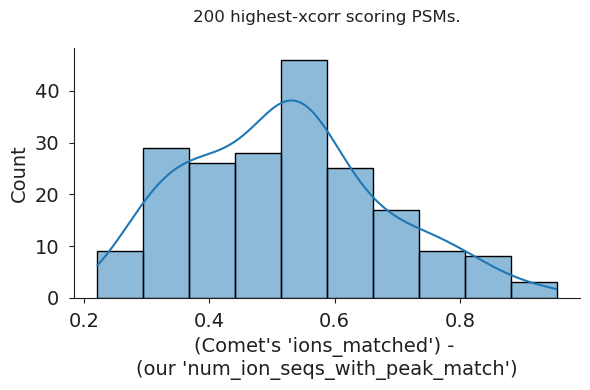

In [ ]:
# Comet
data = filtering[None]
data.head(2)

_, axs = fig_setup()
_=sns.histplot(
    data.ions_matched / data.ions_total,
    ax=axs[0],
    bins=10,
    kde=True,
)
title = f"{num_psms_to_analyze} highest-{XC} scoring PSMs.\n"
set_title_axes_labels(
    ax=axs[0],
    xlabel="(Comet's 'ions_matched') - \n(our 'num_ion_seqs_with_peak_match')",
    ylabel="Count", 
    title=title
)
finalize(axs)
plt.tight_layout()


In [108]:
without_filtering = pd.concat(
    [high_scoring_psms, pd.DataFrame(without_filtering)], 
    axis=1
)
for top_n_peaks in top_n_peak_values:
    filtering[top_n_peaks] = pd.concat(
        [high_scoring_psms, pd.DataFrame(filtering[top_n_peaks])], 
        axis=1
    )

In [ ]:
filtering[50]

,scan,num,charge,exp_neutral_mass,calc_neutral_mass,e-value,xcorr,delta_cn,sp_score,ions_matched,...,retention_time_sec,sp_rank,sample,aa_seq,total_num_peaks,num_peaks_with_ion_match,total_ion_seqs,num_ion_seqs_with_peak_match,charges_to_consider,top_n_peaks
0,2652,1,3,1376.701214,1376.700988,8.370000e-11,5.491,0.6003,2103.0,32,...,1787.0,1,BMEM_AspN_Fxn7,YMVGPIEEAVAKA,50,20,25,16,"[1, 2, 3]",50
1,3297,1,3,1464.721064,1464.720872,6.970000e-09,5.382,0.4686,1301.0,31,...,1860.0,1,BMEM_AspN_Fxn6,DPQVAQLELGGGPGAG,50,20,31,17,"[1, 2, 3]",50
2,3856,1,3,1692.834809,1692.831879,3.280000e-09,5.345,0.6052,896.0,32,...,2259.0,1,BMEM_AspN_Fxn4,DPQVAQLELGGGPGAGDL,50,18,35,18,"[1, 2, 3]",50
3,1901,1,3,1614.840875,1614.836570,1.970000e-08,5.260,0.5580,1653.0,35,...,1661.0,1,BMEM_AspN_Fxn8,DAEKAAVSGLWGKVNA,50,19,31,16,"[1, 2, 3]",50
4,3061,1,3,1464.722867,1464.720872,2.850000e-04,5.191,0.4876,1011.0,30,...,1861.0,1,BMEM_AspN_Fxn5,DPQVAQLELGGGPGAG,50,21,31,17,"[1, 2, 3]",50
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,2980,1,2,1392.606461,1392.604505,2.700000e-06,3.520,0.5259,498.0,13,...,2186.0,1,BMEM_AspN_Fxn8,DELSEVFENQSP,50,8,23,8,"[1, 2, 3]",50
196,3426,1,3,1547.823392,1547.819523,2.520000e-05,3.518,0.4423,766.0,25,...,1966.0,1,BMEM_AspN_Fxn5,DLELQKIAEKFSQ,50,15,25,14,"[1, 2, 3]",50
197,2040,1,3,1582.785434,1582.783866,2.770000e-03,3.517,0.2286,563.0,20,...,1541.0,1,BMEM_AspN_Fxn4,DLEKVEQLSSGLEH,50,12,27,13,"[1, 2, 3]",50
198,3055,1,2,1692.833999,1692.831879,7.460000e-07,3.508,0.5835,900.0,18,...,2261.0,1,BMEM_AspN_Fxn8,DPQVAQLELGGGPGAGDL,50,10,35,12,"[1, 2, 3]",50


## Test for one high-scoring PSM

In [78]:
testing = False
num_psms_to_analyze = 200
ppm_tolerance = 10
charges_to_consider = [1, 2, 3]
top_n_peak_values = [None, 50]

# TESTING
if testing is True:
    print("--TESTING--")
    num_psms_to_analyze = 3
    charges_to_consider = [1, 2]

# Make dataframe with one row per spectrum and that row is the highest scoring row for the spectrum
df = []
for group_name, group in comet_df.groupby([SCAN, SAMPLE]):
    group.sort_values(by="xcorr", ascending=False, inplace=True)
    df.append(group.iloc[0].to_dict())
df = pd.DataFrame(df)

# Get high scoring peptide-spectrum matches and only use one per spectrum
# df.head(5)
df.sort_values(by="xcorr", ascending=False, inplace=True)
df.reset_index(inplace=True, drop=True)


# Select PSM
row = df.iloc[0]

# Populate protein-product-ion database with PSM's protein
fasta_path = "fastas/Uniprot_mouse.fasta"
matching_proteins = get_specific_protein_from_fasta(fasta_path=fasta_path, protein_name=row.protein)
print(f"Number of matching proteins = {len(matching_proteins)}")
protein_seqs = [protein.sequence for protein in matching_proteins]
db = create_protein_product_ion_db(
    protein_seqs=protein_seqs, 
    db_path=":memory:",
    max_kmer_len=30,
    charges_to_consider=[1, 2, 3]
)
print(f"Num product ions in DB: {len(db.read_all_product_ions())}")
print(f"Num proteins in DB: {len(db.read_all_proteins())}")

# Get spectrum corresponding to PSM
spectrum = get_specific_spectrum(sample=row[SAMPLE], scan_num=row[SCAN])

Number of matching proteins = 1
Num product ions in DB: 92610
Num proteins in DB: 1


In [ ]:
ppm_tolerance = 10
top_n_peaks = 100

# Filter peaks to most abundant
peaks = spectrum.peaks
peaks = top_n_peak_filtering(peaks=spectrum.peaks, n=top_n_peaks)

# Find matching product ions
peaks_with_matches = 0
peak_ion_matches = []
for peak in peaks:
    mz_tol = relative_ppm_tolerance_in_daltons(ppm=ppm_tolerance, ref_mass=peak.mz)
    matching_ions = db.get_ions_within_mass_tolerance(query_mass=peak.mz, mz_tolerance=mz_tol)
    if len(matching_ions) > 0:
        peaks_with_matches += 1
        peak_ion_matches.append(
            PeakIonMatches(peak=peak, ions=matching_ions)
        )
        # peak
        # matching_ions
        # peak.id
        # matching_ions
        # break

print(f"For PPM tolerance = {ppm_tolerance}, of {len(peaks)} there are {peaks_with_matches} peaks with > 0 ion matches")
    

For PPM tolerance = 10, of 100 there are 69 peaks with > 0 ion matches


In [ ]:
# peak_ion_match = peak_ion_matches[0]
# peak_ion_match.peak.mz
# peak_ion_match.ions[:5]
# Verify that peak-ion matches are correct
from src.constants import Y_ION_AS_INT

for peak_ion_match in peak_ion_matches:
    peak = peak_ion_match.peak
    for ion in peak_ion_match.ions:
        if ion.ion == Y_ION_AS_INT:
            mass = compute_y_ion_neutral_mass(aa_seq=ion.subsequence, charge=ion.charge)
        else:
            mass = compute_b_ion_neutral_mass(aa_seq=ion.subsequence, charge=ion.charge)

        da_tol = relative_ppm_tolerance_in_daltons(ppm=ppm_tolerance, ref_mass=peak.mz)
        assert abs(mass - peak.mz) <= da_tol

#


In [ ]:
# Collect ions
from itertools import groupby


all_ions = []
for peak_ion_match in peak_ion_matches:
    all_ions.extend(peak_ion_match.ions)

np.unique(list(Counter(all_ions).values()), return_counts=True)

b_ions = list(filter(lambda ion: ion.ion == B_ION_AS_INT, all_ions))
y_ions = list(filter(lambda ion: ion.ion == Y_ION_AS_INT, all_ions))

len(b_ions), len(y_ions)
len(b_ions) + len(y_ions) 
len(all_ions)

# Get lengths of matched ions
# Counter([len(ion.subsequence) for ion in all_ions])


# Group by both protein_id and start
grouped = groupby(b_ions, key=lambda ion: (ion.protein_id, ion.inclusive_start))

# Convert the grouped object to a dictionary
grouped_dict = {key: list(group) for key, group in grouped}

# Output grouped results
min_cluster_size = 2
for key, group in grouped_dict.items():
    if len(group) >= min_cluster_size:
        print(f"{key}: {group}")

# Group by both protein_id and start
grouped = groupby(b_ions, key=lambda ion: (ion.protein_id, ion.exclusive_end))

# Convert the grouped object to a dictionary
grouped_dict = {key: list(group) for key, group in grouped}

# Output grouped results
for key, group in grouped_dict.items():
    
    if len(group) >= min_cluster_size:
        print(f"{key}: {group}")

(array([1]), array([420]))

(226, 194)

420

420

(0, 346): [IonWithProteinInfo(mass=102.05495496688, inclusive_start=346, exclusive_end=347, ion=0, charge=1, protein_id=0, subsequence='T'), IonWithProteinInfo(mass=102.05495496688, inclusive_start=346, exclusive_end=348, ion=0, charge=2, protein_id=0, subsequence='TT'), IonWithProteinInfo(mass=102.05495496688, inclusive_start=346, exclusive_end=349, ion=0, charge=3, protein_id=0, subsequence='TTT')]
(0, 373): [IonWithProteinInfo(mass=102.05495496688, inclusive_start=373, exclusive_end=374, ion=0, charge=1, protein_id=0, subsequence='T'), IonWithProteinInfo(mass=102.05495496688, inclusive_start=373, exclusive_end=375, ion=0, charge=2, protein_id=0, subsequence='TT')]
(0, 349): [IonWithProteinInfo(mass=129.10223946688, inclusive_start=349, exclusive_end=350, ion=0, charge=1, protein_id=0, subsequence='K'), IonWithProteinInfo(mass=129.10223946688, inclusive_start=349, exclusive_end=351, ion=0, charge=2, protein_id=0, subsequence='KK')]
(0, 492): [IonWithProteinInfo(mass=242.1499179668800

['MLSLVGRVASASASGALRGLSPSAALPQAQLLLRAAPAGVHPARDYAAQASAAPKAGTATGRIVAVIGAVVDVQFDEGLPPILNALEVQGRDSRLVLEVAQHLGESTVRTIAMDGTEGLVRGQKVLDSGAPIKIPVGPETLGRIMNVIGEPIDERGPIKTKQFAPIHAEAPEFIEMSVEQEILVTGIKVVDLLAPYAKGGKIGLFGGAGVGKTVLIMELINNVAKAHGGYSVFAGVGERTREGNDLYHEMIESGVINLKDATSKVALVYGQMNEPPGARARVALTGLTVAEYFRDQEGQDVLLFIDNIFRFTQAGSEVSALLGRIPSAVGYQPTLATDMGTMQERITTTKKGSITSVQAIYVPADDLTDPAPATTFAHLDATTVLSRAIAELGIYPAVDPLDSTSRIMDPNIVGNEHYDVARGVQKILQDYKSLQDIIAILGMDELSEEDKLTVSRARKIQRFLSQPFQVAEVFTGHMGKLVPLKETIKGFQQILAGEYDHLPEQAFYMVGPIEEAVAKADKLAEEHGS']

'YMVGPIEEAVAKA'

In [139]:
import re


protein = protein_seqs[0]
row.plain_peptide

matches = list(re.finditer(row.plain_peptide, protein))
len(matches)
for match in matches:
    start_idx, stop_idx = match.span()
    protein[start_idx : stop_idx]

'YMVGPIEEAVAKA'

1

'YMVGPIEEAVAKA'

In [152]:
for ion in all_ions:
    if len(ion.subsequence) >= 5:
        ion

IonWithProteinInfo(mass=230.14991796687997, inclusive_start=515, exclusive_end=520, ion=1, charge=2, protein_id=0, subsequence='AVAKA')

IonWithProteinInfo(mass=242.14991796688003, inclusive_start=492, exclusive_end=497, ion=0, charge=2, protein_id=0, subsequence='QILAG')

IonWithProteinInfo(mass=254.14857703354664, inclusive_start=13, exclusive_end=21, ion=1, charge=3, protein_id=0, subsequence='SGALRGLS')

IonWithProteinInfo(mass=268.16556806688, inclusive_start=79, exclusive_end=84, ion=0, charge=2, protein_id=0, subsequence='PPILN')

IonWithProteinInfo(mass=268.16797156688, inclusive_start=451, exclusive_end=458, ion=1, charge=3, protein_id=0, subsequence='LTVSRAR')

IonWithProteinInfo(mass=274.63050376688005, inclusive_start=507, exclusive_end=512, ion=0, charge=2, protein_id=0, subsequence='YMVGP')

IonWithProteinInfo(mass=286.16725341688, inclusive_start=143, exclusive_end=148, ion=0, charge=2, protein_id=0, subsequence='IMNVI')

IonWithProteinInfo(mass=289.18837266687996, inclusive_start=478, exclusive_end=486, ion=0, charge=3, protein_id=0, subsequence='GKLVPLKE')

IonWithProteinInfo(mass=296.10758976688004, inclusive_start=112, exclusive_end=118, ion=0, charge=2, protein_id=0, subsequence='MDGTEG')

IonWithProteinInfo(mass=317.16937031688, inclusive_start=55, exclusive_end=62, ion=1, charge=2, protein_id=0, subsequence='AGTATGR')

IonWithProteinInfo(mass=317.17115880021333, inclusive_start=75, exclusive_end=84, ion=0, charge=3, protein_id=0, subsequence='DEGLPPILN')

IonWithProteinInfo(mass=317.17026366688, inclusive_start=272, exclusive_end=281, ion=0, charge=3, protein_id=0, subsequence='NEPPGARAR')

IonWithProteinInfo(mass=317.17115880021333, inclusive_start=328, exclusive_end=337, ion=1, charge=3, protein_id=0, subsequence='VGYQPTLAT')

IonWithProteinInfo(mass=317.67395416688004, inclusive_start=257, exclusive_end=263, ion=1, charge=2, protein_id=0, subsequence='LKDATS')

IonWithProteinInfo(mass=317.67395416688004, inclusive_start=352, exclusive_end=358, ion=1, charge=2, protein_id=0, subsequence='SITSVQ')

IonWithProteinInfo(mass=331.16682756688004, inclusive_start=87, exclusive_end=93, ion=1, charge=2, protein_id=0, subsequence='VQGRDS')

IonWithProteinInfo(mass=350.1855794002133, inclusive_start=45, exclusive_end=56, ion=1, charge=3, protein_id=0, subsequence='YAAQASAAPKA')

IonWithProteinInfo(mass=350.18722871688004, inclusive_start=513, exclusive_end=520, ion=0, charge=2, protein_id=0, subsequence='EEAVAKA')

IonWithProteinInfo(mass=353.1819464002133, inclusive_start=374, exclusive_end=384, ion=0, charge=3, protein_id=0, subsequence='TFAHLDATTV')

IonWithProteinInfo(mass=353.18194636688, inclusive_start=464, exclusive_end=470, ion=1, charge=2, protein_id=0, subsequence='SQPFQV')

IonWithProteinInfo(mass=359.18756301688, inclusive_start=232, exclusive_end=239, ion=0, charge=2, protein_id=0, subsequence='FAGVGER')

IonWithProteinInfo(mass=359.19251106688006, inclusive_start=311, exclusive_end=322, ion=1, charge=3, protein_id=0, subsequence='TQAGSEVSALL')

IonWithProteinInfo(mass=359.19251106688006, inclusive_start=513, exclusive_end=520, ion=1, charge=2, protein_id=0, subsequence='EEAVAKA')

IonWithProteinInfo(mass=365.17632966688, inclusive_start=287, exclusive_end=293, ion=1, charge=2, protein_id=0, subsequence='TVAEYF')

IonWithProteinInfo(mass=367.2293424002134, inclusive_start=30, exclusive_end=41, ion=0, charge=3, protein_id=0, subsequence='LLLRAAPAGVH')

IonWithProteinInfo(mass=367.22889656688, inclusive_start=179, exclusive_end=189, ion=1, charge=3, protein_id=0, subsequence='QEILVTGIKV')

IonWithProteinInfo(mass=383.19251101688, inclusive_start=230, exclusive_end=238, ion=1, charge=2, protein_id=0, subsequence='SVFAGVGE')

IonWithProteinInfo(mass=383.1865915335466, inclusive_start=266, exclusive_end=276, ion=1, charge=3, protein_id=0, subsequence='LVYGQMNEPP')

IonWithProteinInfo(mass=395.68812411688003, inclusive_start=86, exclusive_end=93, ion=1, charge=2, protein_id=0, subsequence='EVQGRDS')

IonWithProteinInfo(mass=397.20120176688005, inclusive_start=272, exclusive_end=280, ion=0, charge=2, protein_id=0, subsequence='NEPPGARA')

IonWithProteinInfo(mass=397.20321306688, inclusive_start=305, exclusive_end=311, ion=0, charge=2, protein_id=0, subsequence='DNIFRF')

IonWithProteinInfo(mass=411.18911106688006, inclusive_start=112, exclusive_end=120, ion=1, charge=2, protein_id=0, subsequence='MDGTEGLV')

IonWithProteinInfo(mass=429.20360701687997, inclusive_start=408, exclusive_end=416, ion=1, charge=2, protein_id=0, subsequence='DPNIVGNE')

IonWithProteinInfo(mass=430.2141977002134, inclusive_start=41, exclusive_end=54, ion=1, charge=3, protein_id=0, subsequence='PARDYAAQASAAP')

IonWithProteinInfo(mass=430.2188372335466, inclusive_start=68, exclusive_end=80, ion=1, charge=3, protein_id=0, subsequence='AVVDVQFDEGLP')

IonWithProteinInfo(mass=430.21512886688, inclusive_start=248, exclusive_end=256, ion=0, charge=2, protein_id=0, subsequence='EMIESGVI')

IonWithProteinInfo(mass=430.21512886688, inclusive_start=439, exclusive_end=447, ion=0, charge=2, protein_id=0, subsequence='ILGMDELS')

IonWithProteinInfo(mass=451.20614976688006, inclusive_start=495, exclusive_end=503, ion=1, charge=2, protein_id=0, subsequence='AGEYDHLP')

IonWithProteinInfo(mass=451.20614976687995, inclusive_start=498, exclusive_end=505, ion=1, charge=2, protein_id=0, subsequence='YDHLPEQ')

IonWithProteinInfo(mass=454.2333693335467, inclusive_start=45, exclusive_end=60, ion=0, charge=3, protein_id=0, subsequence='YAAQASAAPKAGTAT')

IonWithProteinInfo(mass=454.2263261335466, inclusive_start=224, exclusive_end=238, ion=0, charge=3, protein_id=0, subsequence='KAHGGYSVFAGVGE')

IonWithProteinInfo(mass=454.2258804002133, inclusive_start=358, exclusive_end=371, ion=1, charge=3, protein_id=0, subsequence='AIYVPADDLTDPA')

IonWithProteinInfo(mass=459.29255946687994, inclusive_start=515, exclusive_end=520, ion=1, charge=1, protein_id=0, subsequence='AVAKA')

IonWithProteinInfo(mass=460.24901936687996, inclusive_start=309, exclusive_end=322, ion=1, charge=3, protein_id=0, subsequence='RFTQAGSEVSALL')

IonWithProteinInfo(mass=460.24781761688, inclusive_start=327, exclusive_end=336, ion=1, charge=2, protein_id=0, subsequence='AVGYQPTLA')

IonWithProteinInfo(mass=472.25142286688003, inclusive_start=4, exclusive_end=15, ion=0, charge=2, protein_id=0, subsequence='VGRVASASASG')

IonWithProteinInfo(mass=472.25276380021336, inclusive_start=415, exclusive_end=427, ion=1, charge=3, protein_id=0, subsequence='EHYDVARGVQKI')

IonWithProteinInfo(mass=486.72470666687997, inclusive_start=498, exclusive_end=506, ion=1, charge=2, protein_id=0, subsequence='YDHLPEQA')

IonWithProteinInfo(mass=492.77165686688005, inclusive_start=510, exclusive_end=520, ion=1, charge=2, protein_id=0, subsequence='GPIEEAVAKA')

IonWithProteinInfo(mass=495.7243722668799, inclusive_start=360, exclusive_end=369, ion=0, charge=2, protein_id=0, subsequence='YVPADDLTD')

IonWithProteinInfo(mass=496.27657506688, inclusive_start=146, exclusive_end=151, ion=0, charge=1, protein_id=0, subsequence='VIGEP')

IonWithProteinInfo(mass=496.27193546688, inclusive_start=152, exclusive_end=165, ion=1, charge=3, protein_id=0, subsequence='DERGPIKTKQFAP')

IonWithProteinInfo(mass=496.27657506688, inclusive_start=396, exclusive_end=401, ion=0, charge=1, protein_id=0, subsequence='AVDPL')

IonWithProteinInfo(mass=496.2719354002133, inclusive_start=417, exclusive_end=430, ion=0, charge=3, protein_id=0, subsequence='YDVARGVQKILQD')

IonWithProteinInfo(mass=496.27193540021335, inclusive_start=418, exclusive_end=431, ion=0, charge=3, protein_id=0, subsequence='DVARGVQKILQDY')

IonWithProteinInfo(mass=496.27657506687996, inclusive_start=509, exclusive_end=514, ion=0, charge=1, protein_id=0, subsequence='VGPIE')

IonWithProteinInfo(mass=520.26131896688, inclusive_start=333, exclusive_end=338, ion=1, charge=1, protein_id=0, subsequence='TLATD')

IonWithProteinInfo(mass=520.2593612002133, inclusive_start=359, exclusive_end=374, ion=1, charge=3, protein_id=0, subsequence='IYVPADDLTDPAPAT')

IonWithProteinInfo(mass=520.26131896688, inclusive_start=378, exclusive_end=383, ion=1, charge=1, protein_id=0, subsequence='LDATT')

IonWithProteinInfo(mass=520.25936116688, inclusive_start=390, exclusive_end=405, ion=0, charge=3, protein_id=0, subsequence='ELGIYPAVDPLDSTS')

IonWithProteinInfo(mass=542.3045210668799, inclusive_start=5, exclusive_end=11, ion=0, charge=1, protein_id=0, subsequence='GRVASA')

IonWithProteinInfo(mass=542.3045210668799, inclusive_start=13, exclusive_end=19, ion=0, charge=1, protein_id=0, subsequence='SGALRG')

IonWithProteinInfo(mass=542.3045211668799, inclusive_start=33, exclusive_end=39, ion=1, charge=1, protein_id=0, subsequence='RAAPAG')

IonWithProteinInfo(mass=542.30260116688, inclusive_start=140, exclusive_end=150, ion=0, charge=2, protein_id=0, subsequence='LGRIMNVIGE')

IonWithProteinInfo(mass=542.30586381688, inclusive_start=509, exclusive_end=520, ion=1, charge=2, protein_id=0, subsequence='VGPIEEAVAKA')

IonWithProteinInfo(mass=545.7743964668799, inclusive_start=356, exclusive_end=366, ion=1, charge=2, protein_id=0, subsequence='VQAIYVPADD')

IonWithProteinInfo(mass=548.2532243335468, inclusive_start=326, exclusive_end=342, ion=1, charge=3, protein_id=0, subsequence='SAVGYQPTLATDMGTM')

IonWithProteinInfo(mass=548.25373106688, inclusive_start=507, exclusive_end=512, ion=0, charge=1, protein_id=0, subsequence='YMVGP')

IonWithProteinInfo(mass=549.25148246688, inclusive_start=313, exclusive_end=319, ion=1, charge=1, protein_id=0, subsequence='AGSEVS')

IonWithProteinInfo(mass=549.25148246688, inclusive_start=314, exclusive_end=320, ion=1, charge=1, protein_id=0, subsequence='GSEVSA')

IonWithProteinInfo(mass=570.32458796688, inclusive_start=23, exclusive_end=29, ion=1, charge=1, protein_id=0, subsequence='AALPQA')

IonWithProteinInfo(mass=570.32828461688, inclusive_start=213, exclusive_end=223, ion=0, charge=2, protein_id=0, subsequence='VLIMELINNV')

IonWithProteinInfo(mass=570.3245878668799, inclusive_start=514, exclusive_end=520, ion=0, charge=1, protein_id=0, subsequence='EAVAKA')

IonWithProteinInfo(mass=588.3364935002132, inclusive_start=124, exclusive_end=142, ion=1, charge=3, protein_id=0, subsequence='VLDSGAPIKIPVGPETLG')

IonWithProteinInfo(mass=588.33917526688, inclusive_start=299, exclusive_end=304, ion=0, charge=1, protein_id=0, subsequence='DVLLF')

IonWithProteinInfo(mass=588.33515256688, inclusive_start=514, exclusive_end=520, ion=1, charge=1, protein_id=0, subsequence='EAVAKA')

IonWithProteinInfo(mass=589.33779506688, inclusive_start=143, exclusive_end=148, ion=1, charge=1, protein_id=0, subsequence='IMNVI')

IonWithProteinInfo(mass=633.33717231688, inclusive_start=134, exclusive_end=146, ion=0, charge=2, protein_id=0, subsequence='PVGPETLGRIMN')

IonWithProteinInfo(mass=633.34244626688, inclusive_start=281, exclusive_end=293, ion=0, charge=2, protein_id=0, subsequence='VALTGLTVAEYF')

IonWithProteinInfo(mass=634.3549929002133, inclusive_start=28, exclusive_end=46, ion=0, charge=3, protein_id=0, subsequence='AQLLLRAAPAGVHPARDY')

IonWithProteinInfo(mass=634.3549929002133, inclusive_start=29, exclusive_end=47, ion=0, charge=3, protein_id=0, subsequence='QLLLRAAPAGVHPARDYA')

IonWithProteinInfo(mass=634.34499731688, inclusive_start=135, exclusive_end=147, ion=0, charge=2, protein_id=0, subsequence='VGPETLGRIMNV')

IonWithProteinInfo(mass=634.34532326688, inclusive_start=302, exclusive_end=312, ion=0, charge=2, protein_id=0, subsequence='LFIDNIFRFT')

IonWithProteinInfo(mass=634.3538766168799, inclusive_start=314, exclusive_end=327, ion=0, charge=2, protein_id=0, subsequence='GSEVSALLGRIPS')

IonWithProteinInfo(mass=634.3424185668799, inclusive_start=314, exclusive_end=333, ion=1, charge=3, protein_id=0, subsequence='GSEVSALLGRIPSAVGYQP')

IonWithProteinInfo(mass=634.34892856688, inclusive_start=416, exclusive_end=427, ion=0, charge=2, protein_id=0, subsequence='HYDVARGVQKI')

IonWithProteinInfo(mass=661.34163486688, inclusive_start=309, exclusive_end=315, ion=0, charge=1, protein_id=0, subsequence='RFTQAG')

IonWithProteinInfo(mass=661.33969186688, inclusive_start=334, exclusive_end=352, ion=1, charge=3, protein_id=0, subsequence='LATDMGTMQERITTTKKG')

IonWithProteinInfo(mass=661.3377950668801, inclusive_start=507, exclusive_end=513, ion=0, charge=1, protein_id=0, subsequence='YMVGPI')

IonWithProteinInfo(mass=662.3402380168799, inclusive_start=162, exclusive_end=174, ion=0, charge=2, protein_id=0, subsequence='FAPIHAEAPEFI')

IonWithProteinInfo(mass=662.3326099668799, inclusive_start=163, exclusive_end=175, ion=1, charge=2, protein_id=0, subsequence='APIHAEAPEFIE')

IonWithProteinInfo(mass=662.34384316688, inclusive_start=229, exclusive_end=241, ion=0, charge=2, protein_id=0, subsequence='YSVFAGVGERTR')

IonWithProteinInfo(mass=662.33822651688, inclusive_start=307, exclusive_end=319, ion=0, charge=2, protein_id=0, subsequence='IFRFTQAGSEVS')

IonWithProteinInfo(mass=662.33554646688, inclusive_start=314, exclusive_end=321, ion=1, charge=1, protein_id=0, subsequence='GSEVSAL')

IonWithProteinInfo(mass=699.3685218668799, inclusive_start=67, exclusive_end=87, ion=1, charge=3, protein_id=0, subsequence='GAVVDVQFDEGLPPILNALE')

IonWithProteinInfo(mass=699.3685218668799, inclusive_start=70, exclusive_end=89, ion=1, charge=3, protein_id=0, subsequence='VDVQFDEGLPPILNALEVQ')

IonWithProteinInfo(mass=699.36500586688, inclusive_start=110, exclusive_end=131, ion=0, charge=3, protein_id=0, subsequence='IAMDGTEGLVRGQKVLDSGAP')

IonWithProteinInfo(mass=699.36500586688, inclusive_start=111, exclusive_end=132, ion=0, charge=3, protein_id=0, subsequence='AMDGTEGLVRGQKVLDSGAPI')

IonWithProteinInfo(mass=699.3650059002133, inclusive_start=136, exclusive_end=155, ion=1, charge=3, protein_id=0, subsequence='GPETLGRIMNVIGEPIDER')

IonWithProteinInfo(mass=699.3650059002133, inclusive_start=137, exclusive_end=156, ion=1, charge=3, protein_id=0, subsequence='PETLGRIMNVIGEPIDERG')

IonWithProteinInfo(mass=699.3650059002133, inclusive_start=138, exclusive_end=157, ion=1, charge=3, protein_id=0, subsequence='ETLGRIMNVIGEPIDERGP')

IonWithProteinInfo(mass=699.36388226688, inclusive_start=279, exclusive_end=298, ion=1, charge=3, protein_id=0, subsequence='ARVALTGLTVAEYFRDQEG')

IonWithProteinInfo(mass=699.36718096688, inclusive_start=513, exclusive_end=520, ion=0, charge=1, protein_id=0, subsequence='EEAVAKA')

IonWithProteinInfo(mass=717.37346636688, inclusive_start=33, exclusive_end=47, ion=0, charge=2, protein_id=0, subsequence='RAAPAGVHPARDYA')

IonWithProteinInfo(mass=717.3795324335466, inclusive_start=368, exclusive_end=389, ion=0, charge=3, protein_id=0, subsequence='DPAPATTFAHLDATTVLSRAI')

IonWithProteinInfo(mass=717.3777456668801, inclusive_start=513, exclusive_end=520, ion=1, charge=1, protein_id=0, subsequence='EEAVAKA')

IonWithProteinInfo(mass=718.3756764335466, inclusive_start=70, exclusive_end=90, ion=1, charge=3, protein_id=0, subsequence='VDVQFDEGLPPILNALEVQG')

IonWithProteinInfo(mass=718.3721604668799, inclusive_start=136, exclusive_end=156, ion=1, charge=3, protein_id=0, subsequence='GPETLGRIMNVIGEPIDERG')

IonWithProteinInfo(mass=718.380990300213, inclusive_start=265, exclusive_end=286, ion=0, charge=3, protein_id=0, subsequence='ALVYGQMNEPPGARARVALTG')

IonWithProteinInfo(mass=718.3710368335468, inclusive_start=280, exclusive_end=299, ion=1, charge=3, protein_id=0, subsequence='RVALTGLTVAEYFRDQEGQ')

IonWithProteinInfo(mass=718.3806226668798, inclusive_start=309, exclusive_end=323, ion=1, charge=2, protein_id=0, subsequence='RFTQAGSEVSALLG')

IonWithProteinInfo(mass=718.3806226668797, inclusive_start=310, exclusive_end=324, ion=1, charge=2, protein_id=0, subsequence='FTQAGSEVSALLGR')

IonWithProteinInfo(mass=762.39133206688, inclusive_start=256, exclusive_end=278, ion=0, charge=3, protein_id=0, subsequence='NLKDATSKVALVYGQMNEPPGA')

IonWithProteinInfo(mass=762.3950765335466, inclusive_start=258, exclusive_end=280, ion=0, charge=3, protein_id=0, subsequence='KDATSKVALVYGQMNEPPGARA')

IonWithProteinInfo(mass=762.3873703335466, inclusive_start=336, exclusive_end=357, ion=1, charge=3, protein_id=0, subsequence='TDMGTMQERITTTKKGSITSV')

IonWithProteinInfo(mass=762.39920936688, inclusive_start=351, exclusive_end=359, ion=1, charge=1, protein_id=0, subsequence='GSITSVQA')

IonWithProteinInfo(mass=790.36897176688, inclusive_start=86, exclusive_end=93, ion=1, charge=1, protein_id=0, subsequence='EVQGRDS')

IonWithProteinInfo(mass=790.38038816688, inclusive_start=507, exclusive_end=514, ion=0, charge=1, protein_id=0, subsequence='YMVGPIE')

IonWithProteinInfo(mass=791.3850116002131, inclusive_start=287, exclusive_end=307, ion=1, charge=3, protein_id=0, subsequence='TVAEYFRDQEGQDVLLFIDN')

IonWithProteinInfo(mass=791.3777512002133, inclusive_start=397, exclusive_end=418, ion=1, charge=3, protein_id=0, subsequence='VDPLDSTSRIMDPNIVGNEHY')

IonWithProteinInfo(mass=791.3777512002133, inclusive_start=399, exclusive_end=420, ion=1, charge=3, protein_id=0, subsequence='PLDSTSRIMDPNIVGNEHYDV')

IonWithProteinInfo(mass=919.42298126688, inclusive_start=507, exclusive_end=515, ion=0, charge=1, protein_id=0, subsequence='YMVGPIEE')

IonWithProteinInfo(mass=984.53692886688, inclusive_start=23, exclusive_end=53, ion=0, charge=3, protein_id=0, subsequence='AALPQAQLLLRAAPAGVHPARDYAAQASAA')

IonWithProteinInfo(mass=984.52771416688, inclusive_start=168, exclusive_end=195, ion=0, charge=3, protein_id=0, subsequence='EAPEFIEMSVEQEILVTGIKVVDLLAP')

IonWithProteinInfo(mass=984.5343079002135, inclusive_start=255, exclusive_end=283, ion=0, charge=3, protein_id=0, subsequence='INLKDATSKVALVYGQMNEPPGARARVA')

IonWithProteinInfo(mass=984.5343079002133, inclusive_start=256, exclusive_end=284, ion=0, charge=3, protein_id=0, subsequence='NLKDATSKVALVYGQMNEPPGARARVAL')

IonWithProteinInfo(mass=984.5310892668797, inclusive_start=374, exclusive_end=393, ion=0, charge=2, protein_id=0, subsequence='TFAHLDATTVLSRAIAELG')

IonWithProteinInfo(mass=984.5436653168799, inclusive_start=381, exclusive_end=400, ion=0, charge=2, protein_id=0, subsequence='TTVLSRAIAELGIYPAVDP')

IonWithProteinInfo(mass=984.53603726688, inclusive_start=510, exclusive_end=520, ion=1, charge=1, protein_id=0, subsequence='GPIEEAVAKA')

IonWithProteinInfo(mass=990.4600950668801, inclusive_start=507, exclusive_end=516, ion=0, charge=1, protein_id=0, subsequence='YMVGPIEEA')

IonWithProteinInfo(mass=1160.57507916688, inclusive_start=224, exclusive_end=246, ion=1, charge=2, protein_id=0, subsequence='KAHGGYSVFAGVGERTREGNDL')

IonWithProteinInfo(mass=1160.5656227668803, inclusive_start=507, exclusive_end=518, ion=0, charge=1, protein_id=0, subsequence='YMVGPIEEAVA')

In [170]:
sorted_ions = sorted(all_ions, key=lambda ion: ion.inclusive_start)

merged_ions = []

for current_ion in sorted_ions:
    start, end = current_ion.inclusive_start, current_ion.exclusive_end
    # if empty
    if len(merged_ions) == 0:
        merged_ions.append([start, end, [current_ion]])
    # if there's overlap
    elif start < merged_ions[-1][1]:
        new_end = max(merged_ions[-1][1], end)
        merged_ions[-1][1] = new_end
        merged_ions[-1][2].append(current_ion)
    # if there's no overlap
    else:
        merged_ions.append([start, end, [current_ion]])


for x in merged_ions:
    # if x[1]-x[0] > 5:
    #     x[0], x[1], x[1]-x[0]
    if x[1]-x[0] > 100:
        x
# merged_ions[0]
merged_ions[-4]

[248,
 431,
 [IonWithProteinInfo(mass=130.04986956688, inclusive_start=248, exclusive_end=249, ion=0, charge=1, protein_id=0, subsequence='E'),
  IonWithProteinInfo(mass=148.06043426688, inclusive_start=248, exclusive_end=249, ion=1, charge=1, protein_id=0, subsequence='E'),
  IonWithProteinInfo(mass=430.21512886688, inclusive_start=248, exclusive_end=256, ion=0, charge=2, protein_id=0, subsequence='EMIESGVI'),
  IonWithProteinInfo(mass=461.20644656688, inclusive_start=249, exclusive_end=253, ion=0, charge=1, protein_id=0, subsequence='MIES'),
  IonWithProteinInfo(mass=243.13393356688, inclusive_start=250, exclusive_end=252, ion=0, charge=1, protein_id=0, subsequence='IE'),
  IonWithProteinInfo(mass=130.04986956688, inclusive_start=251, exclusive_end=252, ion=0, charge=1, protein_id=0, subsequence='E'),
  IonWithProteinInfo(mass=148.06043426688, inclusive_start=251, exclusive_end=252, ion=1, charge=1, protein_id=0, subsequence='E'),
  IonWithProteinInfo(mass=984.5343079002135, inclusiv

[507,
 520,
 [IonWithProteinInfo(mass=274.63050376688005, inclusive_start=507, exclusive_end=512, ion=0, charge=2, protein_id=0, subsequence='YMVGP'),
  IonWithProteinInfo(mass=295.11108956688, inclusive_start=507, exclusive_end=509, ion=0, charge=1, protein_id=0, subsequence='YM'),
  IonWithProteinInfo(mass=394.17950346688, inclusive_start=507, exclusive_end=510, ion=0, charge=1, protein_id=0, subsequence='YMV'),
  IonWithProteinInfo(mass=451.20096716688005, inclusive_start=507, exclusive_end=511, ion=0, charge=1, protein_id=0, subsequence='YMVG'),
  IonWithProteinInfo(mass=548.25373106688, inclusive_start=507, exclusive_end=512, ion=0, charge=1, protein_id=0, subsequence='YMVGP'),
  IonWithProteinInfo(mass=661.3377950668801, inclusive_start=507, exclusive_end=513, ion=0, charge=1, protein_id=0, subsequence='YMVGPI'),
  IonWithProteinInfo(mass=790.38038816688, inclusive_start=507, exclusive_end=514, ion=0, charge=1, protein_id=0, subsequence='YMVGPIE'),
  IonWithProteinInfo(mass=919.4

In [158]:
len({(1,2): 1, "a": 2})

2

In [153]:
# List of intervals defined by (start, end)
intervals = [(1, 5), (3, 7), (8, 10), (2, 4), (9, 12)]

# Sort intervals by start point
intervals.sort()

# Initialize an empty list to store the merged intervals
merged_intervals = []

for current in intervals:
    # If merged_intervals is empty or no overlap with the last interval, just add the current interval
    if not merged_intervals or merged_intervals[-1][1] < current[0]:
        merged_intervals.append(current)
    else:
        # There is overlap, merge the intervals
        merged_intervals[-1] = (merged_intervals[-1][0], max(merged_intervals[-1][1], current[1]))

# The merged_intervals now contain the union of all the sets
print(merged_intervals)

[(1, 7), (8, 12)]


In [150]:
overlapping_ions = []
for ion in all_ions:
    if (ion.inclusive_start >= start_idx) and (ion.inclusive_start <= stop_idx):
        overlapping_ions.append(ion)
len(overlapping_ions)

for ion in overlapping_ions:
    if len(ion.subsequence) >= 2:
        if (ion.inclusive_start == start_idx) or (ion.exclusive_end == stop_idx):
            ion
            # ion.inclusive_start, ion.exclusive_end, ion.subsequence

47

IonWithProteinInfo(mass=194.63136106687998, inclusive_start=516, exclusive_end=520, ion=1, charge=2, protein_id=0, subsequence='VAKA')

IonWithProteinInfo(mass=200.13935326688, inclusive_start=518, exclusive_end=520, ion=0, charge=1, protein_id=0, subsequence='KA')

IonWithProteinInfo(mass=218.14991796688, inclusive_start=518, exclusive_end=520, ion=1, charge=1, protein_id=0, subsequence='KA')

IonWithProteinInfo(mass=230.14991796687997, inclusive_start=515, exclusive_end=520, ion=1, charge=2, protein_id=0, subsequence='AVAKA')

IonWithProteinInfo(mass=274.63050376688005, inclusive_start=507, exclusive_end=512, ion=0, charge=2, protein_id=0, subsequence='YMVGP')

IonWithProteinInfo(mass=289.18703176687995, inclusive_start=517, exclusive_end=520, ion=1, charge=1, protein_id=0, subsequence='AKA')

IonWithProteinInfo(mass=295.11108956688, inclusive_start=507, exclusive_end=509, ion=0, charge=1, protein_id=0, subsequence='YM')

IonWithProteinInfo(mass=350.18722871688004, inclusive_start=513, exclusive_end=520, ion=0, charge=2, protein_id=0, subsequence='EEAVAKA')

IonWithProteinInfo(mass=359.19251106688006, inclusive_start=513, exclusive_end=520, ion=1, charge=2, protein_id=0, subsequence='EEAVAKA')

IonWithProteinInfo(mass=388.25544566687995, inclusive_start=516, exclusive_end=520, ion=1, charge=1, protein_id=0, subsequence='VAKA')

IonWithProteinInfo(mass=394.17950346688, inclusive_start=507, exclusive_end=510, ion=0, charge=1, protein_id=0, subsequence='YMV')

IonWithProteinInfo(mass=451.20096716688005, inclusive_start=507, exclusive_end=511, ion=0, charge=1, protein_id=0, subsequence='YMVG')

IonWithProteinInfo(mass=459.29255946687994, inclusive_start=515, exclusive_end=520, ion=1, charge=1, protein_id=0, subsequence='AVAKA')

IonWithProteinInfo(mass=492.77165686688005, inclusive_start=510, exclusive_end=520, ion=1, charge=2, protein_id=0, subsequence='GPIEEAVAKA')

IonWithProteinInfo(mass=542.30586381688, inclusive_start=509, exclusive_end=520, ion=1, charge=2, protein_id=0, subsequence='VGPIEEAVAKA')

IonWithProteinInfo(mass=548.25373106688, inclusive_start=507, exclusive_end=512, ion=0, charge=1, protein_id=0, subsequence='YMVGP')

IonWithProteinInfo(mass=570.3245878668799, inclusive_start=514, exclusive_end=520, ion=0, charge=1, protein_id=0, subsequence='EAVAKA')

IonWithProteinInfo(mass=588.33515256688, inclusive_start=514, exclusive_end=520, ion=1, charge=1, protein_id=0, subsequence='EAVAKA')

IonWithProteinInfo(mass=661.3377950668801, inclusive_start=507, exclusive_end=513, ion=0, charge=1, protein_id=0, subsequence='YMVGPI')

IonWithProteinInfo(mass=699.36718096688, inclusive_start=513, exclusive_end=520, ion=0, charge=1, protein_id=0, subsequence='EEAVAKA')

IonWithProteinInfo(mass=717.3777456668801, inclusive_start=513, exclusive_end=520, ion=1, charge=1, protein_id=0, subsequence='EEAVAKA')

IonWithProteinInfo(mass=790.38038816688, inclusive_start=507, exclusive_end=514, ion=0, charge=1, protein_id=0, subsequence='YMVGPIE')

IonWithProteinInfo(mass=919.42298126688, inclusive_start=507, exclusive_end=515, ion=0, charge=1, protein_id=0, subsequence='YMVGPIEE')

IonWithProteinInfo(mass=984.53603726688, inclusive_start=510, exclusive_end=520, ion=1, charge=1, protein_id=0, subsequence='GPIEEAVAKA')

IonWithProteinInfo(mass=990.4600950668801, inclusive_start=507, exclusive_end=516, ion=0, charge=1, protein_id=0, subsequence='YMVGPIEEA')

IonWithProteinInfo(mass=1160.5656227668803, inclusive_start=507, exclusive_end=518, ion=0, charge=1, protein_id=0, subsequence='YMVGPIEEAVA')

In [7]:
def get_specific_protein_from_fasta(fasta_path, protein_name):
    pass
protein_name = "sp|P56480|ATPB_MOUSE"
proteins = list(get_proteins_from_fasta(fasta_path="fastas/Uniprot_mouse.fasta"))
protein_names = [
    protein.desc.split(" ")[0] for protein in proteins
]

matching_proteins = list(filter(lambda protein: protein.desc.split(" ")[0] == protein_name, proteins))
len(matching_proteins)


1

In [ ]:
'YMVGPIEEAVAKA'

In [ ]:
row = high_scoring_psms.iloc[0]
peak_ids = []
uniq_b_matches = set([match.peak.id for match in ion_peak_matches.b_matches])
peak_ids.extend([match.peak.id for match in ion_peak_matches.b_matches])
peak_ids.extend([match.peak.id for match in ion_peak_matches.y_matches])
uniq_peak_ids = set(peak_ids)
# b_matches, y_matches = 0, 0
# for match in matches:
#     peak_ids.append(match.peak.id)
#     if match.ion.ion_type == "b":
#         b_matches += 1
#     else:
#         y_matches += 1
return IonPeakMatchingInfo(num_b_matches

# Check that test protein and product ion db has data

In [235]:
from src.erik import generate_kmers
from src.lookups.protein_product_ion_db import ProteinProductIonDb

db_path = "tmp/test.fasta_max_k=30_charges=(1, 2, 3).db"
db = ProteinProductIonDb(db_path=db_path, max_kmer_len=30, reset=False)
tables = [dict(entry) for entry in db.database_info()]
ion_table = [dict(ion) for ion in db.read_all_product_ions()]
protein_table = [dict(prot) for prot in db.read_all_proteins()]

print(f"Num ions = {len(ion_table)}")
print(f"Num proteins = {len(protein_table)}")
print(f"Protens: {protein_table}")

# Confirm that number of 
num_ions = 0
for protein in protein_table:
    kmers = generate_kmers(peptide=protein["sequence"], max_k=30, min_k=1)
    num_ions += 2 * 3 * len(kmers) # "* 2" because there are b- and y-ions
                                   # "* 3" because there are 3 charges to consider
print(f"Expected num ions = {num_ions}")
print(f"Expected num ions == num in table? {num_ions == len(ion_table)}")


Num ions = 726
Num proteins = 2
Protens: [{'protein_id': 0, 'sequence': 'MGRLTSSFLL'}, {'protein_id': 1, 'sequence': 'MYFTFNCLFLL'}]
Expected num ions = 726
Expected num ions == num in table? True


# Full workflow

In [ ]:

from src.erik import parse_mzml
from src.constants import THOMAS_SAMPLES, SPECTRA_DIR

sample = THOMAS_SAMPLES[0]
mzml_path = SPECTRA_DIR / f"{sample}.mzML"

mzml_path

# Load spectra
spectra = list(parse_mzml(mzml_path=mzml_path))

# Load protein + product ion database
# db = ProteinProductIonDb(db_path)



PosixPath('/Users/erjo3868/repos/hypedsearch/hypedsearch/data/spectra/BMEM_AspN_Fxn4.mzML')

[Spectrum(peaks=[Peak(mz=np.float64(54.4022331237793), abundance=np.float64(68.625), id=0), Peak(mz=np.float64(72.4739761352539), abundance=np.float64(39.20000076293945), id=1), Peak(mz=np.float64(86.05862426757812), abundance=np.float64(183.88999938964844), id=2), Peak(mz=np.float64(101.1082534790039), abundance=np.float64(32.19047546386719), id=3), Peak(mz=np.float64(114.0555191040039), abundance=np.float64(715.2930908203125), id=4), Peak(mz=np.float64(129.10386657714844), abundance=np.float64(253.46778869628906), id=5), Peak(mz=np.float64(152.1477813720703), abundance=np.float64(36.565216064453125), id=6), Peak(mz=np.float64(163.97869873046875), abundance=np.float64(151.06532287597656), id=7), Peak(mz=np.float64(169.0947723388672), abundance=np.float64(47.102272033691406), id=8), Peak(mz=np.float64(186.57936096191406), abundance=np.float64(81.33333587646484), id=9), Peak(mz=np.float64(187.12161254882812), abundance=np.float64(137.29855346679688), id=10), Peak(mz=np.float64(199.97276

# OLD

In [66]:
ppm_tol = 10
charges_to_consider = [1, 2, 3]
top_n_peaks = 50

for spectrum in spectra:
    # spectrum.scan_num
    # spectrum.mzml
    matching_rows = comet_df[(comet_df[SCAN] == spectrum.scan_num) & (comet_df[SAMPLE] == spectrum.mzml)]
    if matching_rows.shape[0] == 0:
        continue
    highest_scoring_row = matching_rows.sort_values(by="xcorr", ascending=False).iloc[0]
    
    ion_peak_matches = get_ion_matches_between_peptide_and_spectrum_peaks(
        peptide=highest_scoring_row[PP], 
        charges_to_consider=charges_to_consider,
        ppm_tol=ppm_tol,
        spectrum=spectrum,
    )
    
    peak_ids = []
    b_matches, y_matches = 0, 0
    for match in ion_peak_matches:
        peak_ids.append(match.peak.id)
        if match.ion.ion_type == "b":
            b_matches += 1
        else:
            y_matches += 1

    [len(set(peak_ids)), b_matches, y_matches]
    break

[16, 4, 12]

In [35]:
top_n_peaks = 50

spectrum = spectra[0]

# Filter to most abundant peaks
abundances = [peak.abundance for peak in spectrum.peaks]
indices = get_indices_of_largest_elements(array=abundances, top_n=top_n_peaks)
peaks = np.array(spectrum.peaks)
top_n_peaks = list(peaks[indices])

len(spectrum.peaks)
spectrum.peaks = top_n_peaks
len(spectrum.peaks)
# spectra[0]

82

50

# Testing

In [240]:
# XOR
var1 = None
var2 = None

if (var1 is None) ^ (var2 is None):
    print("One is None, the other is not.")
else:
    print("Both are None or both are not None.")


Both are None or both are not None.
